<a href="https://colab.research.google.com/github/AbdulbariAlqaseer/NewYork-taxi-data-analysis-time-series/blob/main/nyc_taxi_finallllllllll.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# محمد سمير الخطاب + عبد الباري القصير

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import Data And Libraries

In [ ]:
# !unzip -q "/content/drive/MyDrive/Data_Minning_Homework/nyc_taxi_data.zip"

In [ ]:
!pip install -q prophet

In [ ]:
from dask.diagnostics import ProgressBar
from sklearn.preprocessing import FunctionTransformer
import dask.dataframe as dd
import pandas as pd
import numpy as np
import plotly.express as px
import glob
import os
import math
from pandas.plotting import autocorrelation_plot
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa import stattools
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.statespace.sarimax import SARIMAX
from typing import Union
from tqdm import tqdm_notebook
from itertools import product
from prophet import Prophet
from prophet.plot import (plot_plotly, plot_components_plotly,
                          plot_seasonality_plotly,
                          plot_forecast_component_plotly)
from statsmodels.tsa.seasonal import seasonal_decompose
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.metrics import mean_absolute_percentage_error as mape

In [ ]:
import warnings
warnings.filterwarnings('ignore')

# utils

In [ ]:
path_to_save = "/content/nyc_taxi_alt_final/"

In [ ]:
def build_info_ddf(ddf, numeric=False):
    # Notice how we are building the whole info dataframe lazily
    info_ddf = dd.from_pandas(pd.DataFrame(ddf.dtypes), npartitions=1)
    # identifying the missing values from the dataset.
    info_ddf['total_observations'] = ddf.index.size

    info_ddf['missing_val'] = ddf.isnull().sum()

    info_ddf['missing_val_ratio'] = (info_ddf['missing_val'] / ddf.index.size * 100).round().astype(int)

    if numeric:
      info_ddf['negative_val'] = (ddf < 0).sum()
      info_ddf['negative_val_ratio'] = (info_ddf['negative_val'] / ddf.index.size * 100).round(2).astype(float)

    # renaming the first column using rename()
    info_ddf = info_ddf.rename(columns = {0:'data_type'})

    return info_ddf

In [ ]:
def save(ddf, path = path_to_save):
    !mkdir $path
    name_parquet = lambda x: f"part.{x}.parquet"
    with ProgressBar():
        ddf.to_parquet(path, name_function=name_parquet)

In [ ]:
def split_train_test(data, perc):
  length = int(data.shape[0] * perc) // 100
  return data[:length], data[length:]

In [ ]:
layout_options = {
    'paper_bgcolor':"#383838",
    'plot_bgcolor':'#383838',
    'title_font': dict(color='white'),
    'legend_font': dict(color='white'),
    'yaxis':dict(color="white"),
    'xaxis':dict(color="white")
}

In [ ]:
def decompose_model(series, readings_column, layout=layout_options):

  decompose_model = seasonal_decompose(series[readings_column], period=24, model='additive')

  fig = make_subplots(rows=4, cols=1)
  fig.add_trace(go.Scatter(x=series.index, y=series[readings_column],
                          mode='lines', name='Production'), row=1, col=1)

  fig.add_trace(
        go.Scatter(
              x=series.index, y=decompose_model.trend, mode='lines', name='Production Trend'
            ), row=2, col=1
      )

  fig.add_trace(
        go.Scatter(
              x=series.index, y=decompose_model.seasonal, mode='lines', name='Production Seasonality'
            ), row=3, col=1
      )

  fig.add_trace(
        go.Scatter(
              x=series.index, y=decompose_model.resid, mode='lines', name='Production irregular variations'
            ), row=4, col=1
      )
  fig.update_layout(width=1000, **layout)
  fig.update_yaxes(**layout['yaxis'])
  fig.update_xaxes(visible=False)
  fig.show()

In [ ]:
def Naive_Seasonal_Forecast(train, test, column,period=24):

  test_size = len(test)

#   index = -1 * math.ceil(test_size / period) * period
#   if test_size % period == 0:
#     test_predict = train[column][index :].values
#   else:
#     test_predict = train[column][index : index + test_size].values

  # test_predict = train[column][-24 - 1: -24 - 1 + test_size].values
  s = pd.concat(
      [train[column][-period:, ]] * math.ceil(test_size / period)
  )[:test_size]
  return s

In [ ]:
def plot_predict_model(train, test, test_predict, column_target, last_n=0):
  fig, ax = plt.subplots()

  ax.plot(train[-last_n:].index, train[-last_n:][column_target], 'g-.', label='Train')
  ax.plot(test.index, test[column_target], 'b-', label='Test')
  ax.plot(test.index, test_predict, 'r--', label='Predicted')
  ax.set_xlabel('Date')
  ax.set_ylabel(column_target)
  ax.axvspan(test.index[0], test.index[-1], color='#808080', alpha=0.2)
  ax.legend(loc=2)
  s = pd.to_datetime(train[-last_n:].reset_index()["Date"]).dt.hour
  plt.xticks(np.arange(0, len(s), last_n//12), s[::last_n//12])

  fig.autofmt_xdate()
  plt.tight_layout()
  # plt.show()

# 1. Cleaning Data

In [ ]:
ddf = dd.read_parquet('/content/nyc_taxi_alt')
ddf

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee
npartitions=609,,,,,,,,,,,,,,,,,,,
,int64,datetime64[ns],datetime64[ns],float64,float64,float64,object,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 132.14 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,179311700,0,0
PULocationID,int64,179311700,0,0
RatecodeID,float64,179311700,3872186,2
VendorID,int64,179311700,0,0
airport_fee,float64,179311700,115760994,65
congestion_surcharge,float64,179311700,8660504,5
extra,float64,179311700,0,0
fare_amount,float64,179311700,0,0
improvement_surcharge,float64,179311700,0,0
mta_tax,float64,179311700,0,0


## إزالة الأعمدة غير المفيدة

In [ ]:
useful_col = [
    "tpep_pickup_datetime",
    "tpep_dropoff_datetime",
    "VendorID",
    "total_amount",
    "PULocationID",
    "DOLocationID",
    "payment_type",
    "RatecodeID",
    "trip_distance",
    "tip_amount",
    "fare_amount",
    "passenger_count",
]

In [ ]:
ddf = ddf.drop(columns=ddf.columns.drop(useful_col))

## إزالة القيم الفارغة

#### تجربة توزع القيم الفراغة

نأخذ داتافريم جزئي من الداتافريم والذي يحوي قيم فارغة عند عمود الركاب ونبني احصائيات لأجل هذا الجزء

In [ ]:
with ProgressBar():
    df = build_info_ddf(
        ddf[ddf.passenger_count.isna()]
    ).compute()
df

[########################################] | 100% Completed | 84.84 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,3872186,0.0,0
PULocationID,int64,3872186,0.0,0
RatecodeID,float64,3872186,3872186.0,100
VendorID,int64,3872186,0.0,0
fare_amount,float64,3872186,0.0,0
passenger_count,float64,3872186,3872186.0,100
payment_type,int64,3872186,0.0,0
tip_amount,float64,3872186,0.0,0
total_amount,float64,3872186,0.0,0
tpep_dropoff_datetime,datetime64[ns],3872186,0.0,0


نلاحظ أن الأعمدة<br>
* RatecodeID
* passenger_count<br>

تحوي قيم فارغة عند نفس الأسطر مما يمكننا من حذف الأسطر التي تحوي قيم فراغة في أحدها والتي عددها 3872186

### حذف التسجيلات التي تحوي قيم فارغة في عمود عدد الركاب

In [ ]:
ddf = ddf.dropna(subset=["passenger_count"])

In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 79.83 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,175439514,0,0
PULocationID,int64,175439514,0,0
RatecodeID,float64,175439514,0,0
VendorID,int64,175439514,0,0
fare_amount,float64,175439514,0,0
passenger_count,float64,175439514,0,0
payment_type,int64,175439514,0,0
tip_amount,float64,175439514,0,0
total_amount,float64,175439514,0,0
tpep_dropoff_datetime,datetime64[ns],175439514,0,0


نلاحظ اختفاء القيم الفارغة في عدة أعمدة ذلك يعني أن السجلات المحذوفة كانت تحوي قيم فارغة في أكثر من عمود معا

### compute and save

حفظ الداتا

In [ ]:
save(ddf)

mkdir: cannot create directory ‘/content/nyc_taxi_alt_output_missingvalue/’: File exists
[########################################] | 100% Completed | 197.35 s


## Load data

In [ ]:
ddf = dd.read_parquet(path_to_save)

In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 61.17 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,175439514,0,0
PULocationID,int64,175439514,0,0
RatecodeID,float64,175439514,0,0
VendorID,int64,175439514,0,0
fare_amount,float64,175439514,0,0
passenger_count,float64,175439514,0,0
payment_type,int64,175439514,0,0
tip_amount,float64,175439514,0,0
total_amount,float64,175439514,0,0
tpep_dropoff_datetime,datetime64[ns],175439514,0,0


## إزالة القيم المتناقضة و المتطرفة

In [ ]:
numeric = ['trip_distance', 'fare_amount', 'tip_amount', 'total_amount']
categorical = ['passenger_count', 'payment_type', 'RatecodeID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime']
ids = ['VendorID', 'PULocationID', 'DOLocationID']

print(f"{numeric = }\n{categorical = }\n{ids = }")

numeric = ['trip_distance', 'fare_amount', 'tip_amount', 'total_amount']
categorical = ['passenger_count', 'payment_type', 'RatecodeID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime']
ids = ['VendorID', 'PULocationID', 'DOLocationID']


### معالجة الأعمدة الرقمية

#### معالجة القيم المتناقضة

ندرس إحصائيات القيم السالبة

In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf[numeric], True).compute()
df

[########################################] | 100% Completed | 27.89 s


,data_type,total_observations,missing_val,missing_val_ratio,negative_val,negative_val_ratio
fare_amount,float64,175439514,0,0,652466,0.37
tip_amount,float64,175439514,0,0,8828,0.01
total_amount,float64,175439514,0,0,656282,0.37
trip_distance,float64,175439514,0,0,74,0.00


In [ ]:
ddf = ddf[
    (ddf[numeric] >= 0).all(axis='columns')
    ]

و هنا قمنا بحذف كل القيم السالبة المتناقضة من كل الأعمدة الرقمية

In [ ]:
with ProgressBar():
  df = build_info_ddf(ddf[numeric], True).compute()
df

[########################################] | 100% Completed | 31.51 s


,data_type,total_observations,missing_val,missing_val_ratio,negative_val,negative_val_ratio
fare_amount,float64,174783105,0,0,0,0.0
tip_amount,float64,174783105,0,0,0,0.0
total_amount,float64,174783105,0,0,0,0.0
trip_distance,float64,174783105,0,0,0,0.0


ندرس إحصائيات القيم

In [ ]:
with ProgressBar():
    df = ddf[numeric].describe().compute()
df.style.format(thousands=',')

[########################################] | 100% Completed | 78.60 s


,trip_distance,fare_amount,tip_amount,total_amount
count,"174,783,105.000000","174,783,105.000000","174,783,105.000000","174,783,105.000000"
mean,3.085927,13.458628,2.332162,19.563097
std,34.176001,181.689311,11.091542,201.140591
min,0.000000,0.000000,0.000000,0.000000
25%,1.210000,8.000000,1.000000,12.360000
50%,2.090000,12.000000,2.260000,16.560000
75%,4.200000,24.000000,4.550000,33.240000
max,"184,340.800000","998,310.030000","141,492.020000","1,084,772.170000"


نلاحظ وجود قيم صفرية في أعمدة المسافة و المبالغ  نقوم بحذفهم قبل البدء ب إزالة القيم المتطرفة من هذه الأعمدة

In [ ]:
ddf = ddf[
    (~(ddf["trip_distance"] == 0)) &
    (~(ddf["fare_amount"] == 0)) &
    (~(ddf["total_amount"] == 0))
]

#### معالجة القيم المتطرفة

نقوم بتعريف تابع لحذف القيم المتطرفة

In [ ]:
def apply_iqr(ddf, column):
    q1 = ddf[column].quantile(0.25).compute()
    q3 = ddf[column].quantile(0.75).compute()
    IQR = q3 - q1
    lower_bound = q1 - 1.5 * IQR
    upper_bound = q3 + 1.5 * IQR
    return ddf[(ddf[column] >= lower_bound) & (ddf[column] <= upper_bound)]

In [ ]:
with ProgressBar():
    ddf = apply_iqr(ddf, "trip_distance")
    ddf = apply_iqr(ddf, "fare_amount")
    ddf = apply_iqr(ddf, "tip_amount")
    ddf = apply_iqr(ddf, "total_amount")

[########################################] | 100% Completed | 68.86 s
[########################################] | 100% Completed | 60.95 s
[########################################] | 100% Completed | 70.14 s
[########################################] | 100% Completed | 71.62 s
[########################################] | 100% Completed | 78.02 s
[########################################] | 100% Completed | 87.19 s
[########################################] | 100% Completed | 88.61 s
[########################################] | 100% Completed | 87.12 s


In [ ]:
with ProgressBar():
    df = ddf[numeric].describe().compute()
df.style.format(thousands=',')

[########################################] | 100% Completed | 139.31 s


,trip_distance,fare_amount,tip_amount,total_amount
count,"157,514,161.000000","157,514,161.000000","157,514,161.000000","157,514,161.000000"
mean,2.069843,10.283058,1.865416,15.592767
std,1.585085,5.262902,1.568070,6.292153
min,0.010000,0.010000,0.000000,0.010000
25%,1.170000,7.500000,1.000000,12.300000
50%,1.870000,11.000000,2.160000,15.360000
75%,3.090000,17.700000,3.800000,25.600000
max,8.790000,34.850000,8.390000,42.150000


### معالجة الأعمدة غير الرقمية

In [ ]:
with ProgressBar():
    print(ddf["VendorID"].value_counts().compute())

[########################################] | 100% Completed | 94.20 s
2    104685891
1     52828270
Name: VendorID, dtype: int64


نلاحظ أن عمود الوكالة لا يحوي قيم متناقضة أو متطرفة

---

In [ ]:
with ProgressBar():
    print(ddf["passenger_count"].value_counts().compute())

[########################################] | 100% Completed | 91.77 s
1.0      113557541
2.0       23375494
3.0        6397282
5.0        5058342
0.0        3127216
6.0        3112765
4.0        2885403
7.0             60
9.0             31
8.0             25
96.0             1
112.0            1
Name: passenger_count, dtype: int64


نلاحظ أن كل القيم الأكبر من 6 في هذا العمود هي قيم متطرفة لذلك سنقوم بحذفها

In [ ]:
ddf = ddf[ddf['passenger_count'] < 7]

و هنا قمنا بحذف الأسطر التي تحوي قيم متطرفة من عدد الركاب

---

In [ ]:
with ProgressBar():
    print(ddf["RatecodeID"].value_counts().compute())

[########################################] | 100% Completed | 111.61 s
1.0     157301814
5.0        104210
99.0        69989
4.0         20244
3.0         16901
2.0           521
6.0           364
Name: RatecodeID, dtype: int64


نلاحظ وجود قيمة متناقضة و هي 99 لذلك نقوم بحذفها

In [ ]:
ddf = ddf[ddf['RatecodeID'] != 99]

---

In [ ]:
with ProgressBar():
    print(ddf["payment_type"].value_counts().compute())

[########################################] | 100% Completed | 115.76 s
1    117443099
2     39235784
3       535940
4       229218
5           13
Name: payment_type, dtype: int64


نلاحظ عدم وجود قيم متناقضة<br>

---

نتحقق من وجود قيم صفرية أو سالبة في معرف الموقع

In [ ]:
with ProgressBar():
  df = ddf[(ddf["PULocationID"] <= 0) & (ddf["DOLocationID"] <= 0)].head(npartitions=609)
df

[########################################] | 100% Completed | 107.01 s


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount


### معالجة الأعمدة الزمنية

نختبر القيم المتناقضة

In [ ]:
with ProgressBar():
    df = ddf[ddf['tpep_dropoff_datetime'] <= ddf['tpep_pickup_datetime']].compute()
df

[########################################] | 100% Completed | 48.98 s


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,duration_minute
136825,2,2019-01-01 17:24:51,2019-01-01 17:24:51,2.0,0.02,1.0,264,264,2,2.5,0.0,3.3,0
210324,1,2019-01-02 07:14:37,2019-01-02 07:14:37,1.0,0.70,1.0,231,231,2,5.0,0.0,5.8,0
232023,2,2019-01-02 09:09:32,2019-01-02 09:09:32,1.0,0.01,1.0,264,264,2,2.5,0.0,3.3,0
250002,1,2019-01-02 11:35:49,2019-01-02 11:35:49,3.0,4.00,1.0,13,13,2,15.0,0.0,15.8,0
253747,1,2019-01-02 11:25:14,2019-01-02 11:25:14,1.0,0.60,1.0,43,43,1,4.5,1.5,6.8,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3000522,1,2022-12-28 21:43:48,2022-12-28 21:43:48,2.0,2.00,1.0,100,100,1,13.5,3.7,22.2,0
3087861,1,2022-12-29 21:01:23,2022-12-29 21:01:23,1.0,3.50,1.0,141,141,1,21.9,1.0,27.9,0
3106221,2,2022-12-30 02:33:53,2022-12-30 02:33:53,1.0,0.01,1.0,264,264,2,3.0,0.0,5.5,0
3114462,1,2022-12-30 09:30:56,2022-12-30 09:30:56,1.0,0.70,1.0,164,164,1,7.2,2.2,13.4,0


نلاحظ وجود عينات فيها زمن انتهاء الرحلة أصغر أو يساوي زمن بدي الرحلة

نقوم بحذف هذه الأعمدة

In [ ]:
ddf = ddf[~(ddf['tpep_dropoff_datetime'] <= ddf['tpep_pickup_datetime'])]

معالجة القيم المتطرفة

In [ ]:
ddf = ddf[
    (ddf['tpep_pickup_datetime'].dt.year > 2018) &
    (ddf['tpep_pickup_datetime'].dt.year <= 2022) &

    (ddf['tpep_dropoff_datetime'].dt.year > 2018) &
    (ddf['tpep_dropoff_datetime'].dt.year <= 2022)
]

In [ ]:
ddf["duration_minute"] = (ddf['tpep_dropoff_datetime'] - ddf['tpep_pickup_datetime']).dt.total_seconds() // 60

ازالة الأسطر التي لم تستغرق دقيقة ك مدة رحلة

In [ ]:
ddf = ddf[~(ddf["duration_minute"] == 0)]

In [ ]:
with ProgressBar():
    df = ddf["duration_minute"].describe().compute()
df

[########################################] | 100% Completed | 134.14 s


count    1.551492e+08
mean     1.131994e+01
std      6.921750e+00
min      1.000000e+00
25%      7.000000e+00
50%      1.200000e+01
75%      1.800000e+01
max      3.500000e+01
Name: duration_minute, dtype: float64

In [ ]:
with ProgressBar():
    ddf = apply_iqr(ddf, "duration_minute")

[########################################] | 100% Completed | 209.86 s
[########################################] | 100% Completed | 216.44 s


In [ ]:
with ProgressBar():
    df = ddf["duration_minute"].describe().compute()
df

In [ ]:
ddf = ddf.drop(columns=["duration_minute"])

### compute and save

حفظ الداتا

In [ ]:
save(ddf)

mkdir: cannot create directory ‘/content/nyc_taxi_alt_output_missingvalue/’: File exists
[########################################] | 100% Completed | 240.95 s


## معالجة التكرارات

In [ ]:
def drop_duplicate_partition(partition):
    return partition.drop_duplicates()
ddf = ddf.repartition(npartitions=25)
ddf = ddf.map_partitions(drop_duplicate_partition)
ddf = ddf.repartition(npartitions=609)

In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 210.65 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,155150439,0,0
PULocationID,int64,155150439,0,0
RatecodeID,float64,155150439,0,0
VendorID,int64,155150439,0,0
duration_minute,float64,155150439,0,0
fare_amount,float64,155150439,0,0
passenger_count,float64,155150439,0,0
payment_type,int64,155150439,0,0
tip_amount,float64,155150439,0,0
total_amount,float64,155150439,0,0


### compute and save

حفظ الداتا

In [ ]:
save(ddf)

mkdir: cannot create directory ‘/content/nyc_taxi_alt_output_missingvalue/’: File exists
[########################################] | 100% Completed | 240.95 s


## Load data

In [ ]:
ddf = dd.read_parquet('/content/drive/MyDrive/Data_Minning_Homework/nyc_taxi_alt_final')

In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 62.70 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,155149155,0,0
PULocationID,int64,155149155,0,0
RatecodeID,float64,155149155,0,0
VendorID,int64,155149155,0,0
fare_amount,float64,155149155,0,0
passenger_count,float64,155149155,0,0
payment_type,int64,155149155,0,0
tip_amount,float64,155149155,0,0
total_amount,float64,155149155,0,0
tpep_dropoff_datetime,datetime64[ns],155149155,0,0


## إنشاء السلسلة الزمنية

قمنا باختيار الأعمدة المراد استخدامها بالسلسلة الزمنية

In [ ]:
ddf2 = ddf[['VendorID', 'tpep_pickup_datetime', 'total_amount']]

قمنا بإنشاء سلسلة زمنية لكل وكالة

In [ ]:
with ProgressBar():
  LLC_series = ddf2[ddf2['VendorID'] == 1].rename(columns={"tpep_pickup_datetime": "Date"}).set_index(['Date'])
  VeriFone_series = ddf2[ddf2['VendorID'] == 2].rename(columns={"tpep_pickup_datetime": "Date"}).set_index(['Date'])

[########################################] | 100% Completed | 130.29 s
[########################################] | 100% Completed | 79.92 s


In [ ]:
del ddf2

In [ ]:
LLC_series.head()

,VendorID,total_amount
Date,,
2019-01-01 00:00:03,1,6.3
2019-01-01 00:00:14,1,4.3
2019-01-01 00:00:18,1,25.3
2019-01-01 00:00:19,1,9.8
2019-01-01 00:00:25,1,5.8


قمنا بتجميع السلاسل حسب كل ساعة

In [ ]:
LLC_series = LLC_series['total_amount'].resample('1H')
VeriFone_series = VeriFone_series['total_amount'].resample('1H')

قمنا بتطبيق تابع التجميع لحساب مجموع الإرادات و عدد الرحلات

In [ ]:
LLC_series = LLC_series.agg([np.sum, lambda x: x.count()]).compute()
VeriFone_series = VeriFone_series.agg([np.sum, lambda x: x.count()]).compute()

قمنا بإعادة تسمية الأعمدة لسهولة القراءة

In [ ]:
LLC_series = LLC_series.rename(columns={"sum": "Total Amount", "<lambda>":"Count"})
VeriFone_series = VeriFone_series.rename(columns={"sum": "Total Amount", "<lambda>":"Count"})

In [ ]:
LLC_series.head()

,Total Amount,Count
Date,,
2019-01-01 00:00:00,59990.63,4385
2019-01-01 01:00:00,74674.71,5237
2019-01-01 02:00:00,61195.97,4341
2019-01-01 03:00:00,46810.84,3443
2019-01-01 04:00:00,31755.72,2255


## Augmented Dickey-Fuller (ADF)

أولاً سنقوم بعرض كامل السلسلة الزمنية الاولى بالنسبة لعامود الإرادات الكلية مع اتجاه السلسلة و الفصلية
الخاصة بها بالنسبة للإرادات الكلية

In [ ]:
decompose_model(LLC_series, "Total Amount")

قمنا باختبار استقرار السلسلة الاولى بالنسبة لعامود الإرادات الكلية


In [ ]:
adf, p_value, _, _, critical_values, _ = stattools.adfuller(LLC_series['Total Amount'])

print(f'ADF Statistic: {adf}')
print(f'p-value: {p_value}')
critical_values

ADF Statistic: -5.913795646992318
p-value: 2.601368188974907e-07


{'1%': -3.43053679213716, '5%': -2.8616225575095284, '10%': -2.566813942767471}

In [ ]:
print('Probably ' + ('Non_Stationary' if adf > critical_values['5%'] else 'Stationary'))

Probably Stationary


نلاحظ أن السلسلة الاولى بالنسبة لعامود الإرادات الكلية مستقرة

---

ثم سنقوم بعرض كامل السلسلة الزمنية الاولى مع اتجاه السلسلة و الفصلية
الخاصة بها بالنسبة لعدد الرحلات

In [ ]:
decompose_model(LLC_series, "Count")

قمنا باختبار استقرار السلسلة الاولى بالنسبة لعامود عدد الرحلات


In [ ]:
adf, p_value, _, _, critical_values, _ = stattools.adfuller(LLC_series['Count'])

print(f'ADF Statistic: {adf}')
print(f'p-value: {p_value}')
critical_values

ADF Statistic: -5.081722090977517
p-value: 1.5255191162101094e-05


{'1%': -3.43053679213716, '5%': -2.8616225575095284, '10%': -2.566813942767471}

In [ ]:
print('Probably ' + ('Non_Stationary' if adf > critical_values['5%'] else 'Stationary'))

Probably Stationary


نلاحظ أن السلسلة الاولى بالنسبة لعدد الرحلات مستقرة

---

ثانياً سنقوم بعرض كامل السلسلة الزمنية الثانية مع اتجاه السلسلة و الفصلية
الخاصة بها بالنسبة للإرادات الكلية

In [ ]:
decompose_model(VeriFone_series, "Total Amount")

قمنا باختبار استقرار السلسلة الثانية بالنسبة للإرادات الكلية


In [ ]:
adf, p_value, _, _, critical_values, _ = stattools.adfuller(VeriFone_series['Total Amount'])

print(f'ADF Statistic: {adf}')
print(f'p-value: {p_value}')
critical_values

ADF Statistic: -6.0434549563161815
p-value: 1.3289718587548464e-07


{'1%': -3.43053679213716, '5%': -2.8616225575095284, '10%': -2.566813942767471}

In [ ]:
print('Probably ' + ('Non_Stationary' if adf > critical_values['5%'] else 'Stationary'))

Probably Stationary


نلاحظ أن السلسلة الثانية بالنسبة لعامود الإرادات الكلية مستقرة

---

ثم سنقوم بعرض كامل السلسلة الزمنية الثانية مع اتجاه السلسلة و الفصلية
الخاصة بها بالنسبة لعدد الرحلات

In [ ]:
decompose_model(VeriFone_series, "Count")

قمنا باختبار استقرار السلسلة الثانية بالنسبة لعامود عدد الرحلات


In [ ]:
adf, p_value, _, _, critical_values, _ = stattools.adfuller(VeriFone_series['Count'])

print(f'ADF Statistic: {adf}')
print(f'p-value: {p_value}')
critical_values

ADF Statistic: -5.221469661494477
p-value: 7.946768125535957e-06


{'1%': -3.43053678680168, '5%': -2.861622555151452, '10%': -2.5668139415123283}

In [ ]:
print('Probably ' + ('Non_Stationary' if adf > critical_values['5%'] else 'Stationary'))

Probably Stationary


نلاحظ أن السلسلة الثانية بالنسبة لعدد الرحلات مستقرة

## Save CSV

In [ ]:
LLC_series.reset_index().to_csv('/content/drive/MyDrive/Data_Minning_Homework/LLC_data.csv', index=False)
VeriFone_series.reset_index().to_csv('/content/drive/MyDrive/Data_Minning_Homework/VeriFone_data.csv', index=False)

## Save Long Format

In [ ]:
LLC_long_format = pd.melt(LLC_series.reset_index(), id_vars='Date', value_vars=['Total Amount', 'Count'])
VeriFone_long_format = pd.melt(VeriFone_series.reset_index(), id_vars='Date', value_vars=['Total Amount', 'Count'])

In [ ]:
LLC_long_format.to_csv('/content/drive/MyDrive/Data_Minning_Homework/LLC_long_format_data.csv', index=False)
VeriFone_long_format.to_csv('/content/drive/MyDrive/Data_Minning_Homework/VeriFone_long_format_data.csv', index=False)

# 2. Feature Enginering

## Load data

In [ ]:
ddf = dd.read_parquet('/content/drive/MyDrive/Data_Minning_Homework/nyc_taxi_alt_final')

In [ ]:
ddf

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount
npartitions=609,,,,,,,,,,,,
,int64,datetime64[ns],datetime64[ns],float64,float64,float64,int64,int64,int64,float64,float64,float64
,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...


In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 111.31 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,155149155,0,0
PULocationID,int64,155149155,0,0
RatecodeID,float64,155149155,0,0
VendorID,int64,155149155,0,0
fare_amount,float64,155149155,0,0
passenger_count,float64,155149155,0,0
payment_type,int64,155149155,0,0
tip_amount,float64,155149155,0,0
total_amount,float64,155149155,0,0
tpep_dropoff_datetime,datetime64[ns],155149155,0,0


---

In [ ]:
zone_df = pd.read_csv('/content/drive/MyDrive/Data_Minning_Homework/taxi_zone_lookup.csv')
zone_df.head()

,LocationID,Borough,Zone,service_zone
0,1,EWR,Newark Airport,EWR
1,2,Queens,Jamaica Bay,Boro Zone
2,3,Bronx,Allerton/Pelham Gardens,Boro Zone
3,4,Manhattan,Alphabet City,Yellow Zone
4,5,Staten Island,Arden Heights,Boro Zone


## إنشاء السمات

قمنا بدمج الداتافريم التي لدينا مع ملف المناطق المرفق للحصول على اسم منطقة و بلدية مكان انطلاق الرحلة و من ثم تعبئة القيم الفارغة بقيمة (غير معروف)



In [ ]:
ddf = ddf.merge(zone_df[['LocationID', 'Zone', 'Borough']], left_on='PULocationID', right_on='LocationID', how='left').drop(columns=['LocationID'])
ddf = ddf.rename(columns={'Zone':'source_zone', 'Borough':'source_borough'})
ddf = ddf.fillna('Unknown')

In [ ]:
with ProgressBar():
  df = ddf['source_zone'].isna().value_counts().compute()
df

[########################################] | 100% Completed | 162.44 s


False    155149155
Name: source_zone, dtype: int64

In [ ]:
with ProgressBar():
  df = ddf['source_borough'].isna().value_counts().compute()
df

[########################################] | 100% Completed | 158.14 s


False    155149155
Name: source_borough, dtype: int64

---

قمنا بدمج الداتافريم التي لدينا مع ملف المناطق المرفق للحصول على اسم منطقة و بلدية مكان وصول الرحلة و من ثم تعبئة القيم الفارغة بقيمة (غير معروف)

In [ ]:
ddf = ddf.merge(zone_df[['LocationID', 'Zone', 'Borough']], left_on='DOLocationID', right_on='LocationID', how='left').drop(columns=['LocationID'])
ddf = ddf.rename(columns={'Zone':'destination_zone', 'Borough':'destination_borough'})
ddf = ddf.fillna('Unknown')

In [ ]:
with ProgressBar():
  df = ddf['destination_zone'].isna().value_counts().compute()
df

[########################################] | 100% Completed | 335.90 s


False    155149155
Name: destination_zone, dtype: int64

In [ ]:
with ProgressBar():
  df = ddf['destination_borough'].isna().value_counts().compute()
df

[########################################] | 100% Completed | 335.63 s


False    155149155
Name: destination_borough, dtype: int64

---

قمنا بدمج عامود اسم منطقة الانطلاق مع عامود اسم منطقة الوصول بعد أن قمنا بترتيبهم حسب الأبجدية

In [ ]:
ddf['location_pair'] = ddf[['source_zone', 'destination_zone']].apply(lambda x : ",".join(sorted(x)),
                                                                      axis=1, meta=('location_pair', 'object'))

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,location_pair
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,1.65,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,"Manhattan Valley,Upper West Side South"
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,1.00,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,"Upper West Side South,West Chelsea/Hudson Yards"
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,1.25,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,"Midtown North,Sutton Place/Turtle Bay North"
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,3.70,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,"Astoria,Sutton Place/Turtle Bay North"
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,1.70,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,"Lenox Hill West,Union Sq"


---

قمنا بمطابقة معرف وسيلة الدفع بالاسم الذي يلائمه من ملف الإرشادات

In [ ]:
ddf['payment_type_name'] = ddf['payment_type'].map({1:'Credit card', 2:'Cash', 3:'No charge', 4:'Dispute', 5:'Unknown'})

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,location_pair,payment_type_name
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,1.65,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,"Manhattan Valley,Upper West Side South",Credit card
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,1.00,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,"Upper West Side South,West Chelsea/Hudson Yards",Credit card
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,1.25,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,"Midtown North,Sutton Place/Turtle Bay North",Credit card
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,3.70,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,"Astoria,Sutton Place/Turtle Bay North",Credit card
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,1.70,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,"Lenox Hill West,Union Sq",Credit card


---

قمنا بمطابقة معرف الوكالة بالاسم الذي يلائمه

In [ ]:
ddf['vendor'] = ddf['VendorID'].map({1:'LLC', 2:'VeriFone'})

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,location_pair,payment_type_name,vendor
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,1.65,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,"Manhattan Valley,Upper West Side South",Credit card,LLC
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,1.00,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,"Upper West Side South,West Chelsea/Hudson Yards",Credit card,LLC
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,1.25,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,"Midtown North,Sutton Place/Turtle Bay North",Credit card,LLC
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,3.70,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,"Astoria,Sutton Place/Turtle Bay North",Credit card,LLC
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,1.70,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,"Lenox Hill West,Union Sq",Credit card,LLC


---

قمنا بمطابقة معرف كود التقييم بالاسم الذي يلائمه

In [ ]:
ddf['rate_code'] = ddf['RatecodeID'].map({1:'Standard rate', 2:'JFK', 3:'Newark',
                                          4:'Nassau or Westchester', 5:'Negotiated fare', 6:'Group ride'})

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,location_pair,payment_type_name,vendor,rate_code
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,1.65,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,"Manhattan Valley,Upper West Side South",Credit card,LLC,Standard rate
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,1.00,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,"Upper West Side South,West Chelsea/Hudson Yards",Credit card,LLC,Standard rate
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,1.25,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,"Midtown North,Sutton Place/Turtle Bay North",Credit card,LLC,Standard rate
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,3.70,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,"Astoria,Sutton Place/Turtle Bay North",Credit card,LLC,Standard rate
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,1.70,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,"Lenox Hill West,Union Sq",Credit card,LLC,Standard rate


---

قمنا بتجميع عامود ثنائية المكان لمعرفة عدد الرحلات من أجل كل ثنائية فريدة

In [ ]:
with ProgressBar():
  df = ddf['location_pair'].value_counts().compute()
df

[########################################] | 100% Completed | 24m 48s


Upper East Side North,Upper East Side South      2176953
Lincoln Square East,Upper West Side South         930309
Midtown Center,Upper East Side South              921565
Upper West Side North,Upper West Side South       907029
Upper East Side North,Upper East Side North       860090
                                                  ...   
Lenox Hill East,Ocean Parkway South                    1
Brooklyn Heights,Flushing Meadows-Corona Park          1
North Corona,West Concourse                            1
Brooklyn Heights,Forest Park/Highland Park             1
Midtown East,Van Nest/Morris Park                      1
Name: location_pair, Length: 14742, dtype: int64

In [ ]:
df.describe()

count    1.474200e+04
mean     1.052429e+04
std      5.303894e+04
min      1.000000e+00
25%      4.000000e+00
50%      5.500000e+01
75%      7.507500e+02
max      2.176953e+06
Name: location_pair, dtype: float64

In [ ]:
len(df)

14742

قمنا بتحويل السلسلة الناتجة من الخطوة السابقة إلى سلسلة فئوية و اعتمدنا في التقطيع على المجالات الاحصائية السابقة

In [ ]:
bins = [0, 4, 55, 750, np.inf]
labels = ['rare', 'less-common', 'common', 'more-common']
transformer = FunctionTransformer(pd.cut, kw_args={'bins': bins,
                                                   'labels': labels,
                                                   'retbins': False})
location_pair_categories = transformer.fit_transform(df)

In [ ]:
location_pair_categories

Upper East Side North,Upper East Side South      more-common
Lincoln Square East,Upper West Side South        more-common
Midtown Center,Upper East Side South             more-common
Upper West Side North,Upper West Side South      more-common
Upper East Side North,Upper East Side North      more-common
                                                    ...     
Lenox Hill East,Ocean Parkway South                     rare
Brooklyn Heights,Flushing Meadows-Corona Park           rare
North Corona,West Concourse                             rare
Brooklyn Heights,Forest Park/Highland Park              rare
Midtown East,Van Nest/Morris Park                       rare
Name: location_pair, Length: 14742, dtype: category
Categories (4, object): ['rare' < 'less-common' < 'common' < 'more-common']

In [ ]:
pd.Categorical(location_pair_categories).describe()

,counts,freqs
categories,,
rare,3717,0.252137
less-common,3661,0.248338
common,3678,0.249491
more-common,3686,0.250034


نلاحظ توزع عدد الرحلات على المجالات التي حددناها بشكل شبه متساوي

قمنا بوضع قيم ثنائيات المكان و عدد الرحلات المقابلة للثنائية و الفئة التي تنتمي إليها هذه الثنائية في داتافريم لسهولة التعامل

In [ ]:
df_location_pair = pd.DataFrame(list(df.items()), columns=['location_pair', 'Count'])
df_location_pair['categorical'] = list(location_pair_categories)

In [ ]:
df_location_pair

,location_pair,Count,categorical
0,"Upper East Side North,Upper East Side South",2176953,more-common
1,"Lincoln Square East,Upper West Side South",930309,more-common
2,"Midtown Center,Upper East Side South",921565,more-common
3,"Upper West Side North,Upper West Side South",907029,more-common
4,"Upper East Side North,Upper East Side North",860090,more-common
...,...,...,...
14737,"Lenox Hill East,Ocean Parkway South",1,rare
14738,"Brooklyn Heights,Flushing Meadows-Corona Park",1,rare
14739,"North Corona,West Concourse",1,rare
14740,"Brooklyn Heights,Forest Park/Highland Park",1,rare


قمنا بدمج الداتافريم الأساسية مع الداتافريم الناتجة من الخطوة السابقة للحصول على الفئة التي تنتمي إليها ثنائية المكان

In [ ]:
ddf = ddf.merge(df_location_pair[['location_pair', 'categorical']], left_on='location_pair', right_on='location_pair',
                how='left').drop(columns=['location_pair'])
ddf = ddf.rename(columns={'categorical':'trip_class'})

In [ ]:
with ProgressBar():
  df = ddf['trip_class'].isna().value_counts().compute()
df

[########################################] | 100% Completed | 28m 41s


False    155149155
Name: trip_class, dtype: int64

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,payment_type_name,vendor,rate_code,trip_class
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,1.65,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,Credit card,LLC,Standard rate,more-common
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,1.00,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,Credit card,LLC,Standard rate,more-common
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,1.25,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,Credit card,LLC,Standard rate,more-common
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,3.70,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,Credit card,LLC,Standard rate,more-common
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,1.70,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,Credit card,LLC,Standard rate,more-common


---

قمنا بطرح عامود زمن انطلاق الرحلة من عامود زمن وصول الرحلة و من ثم تحويل الناتج إلى دقائق

In [ ]:
ddf["trip_duration"] = (ddf['tpep_dropoff_datetime'] - ddf['tpep_pickup_datetime']).dt.total_seconds() // 60

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,...,total_amount,source_zone,source_borough,destination_zone,destination_borough,payment_type_name,vendor,rate_code,trip_class,trip_duration
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,1.5,1.0,151,239,1,7.0,...,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,Credit card,LLC,Standard rate,more-common,6.0
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,2.6,1.0,239,246,1,14.0,...,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,Credit card,LLC,Standard rate,more-common,19.0
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,1.3,1.0,163,229,1,6.5,...,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,Credit card,LLC,Standard rate,more-common,7.0
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,3.7,1.0,229,7,1,13.5,...,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,Credit card,LLC,Standard rate,more-common,13.0
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,2.1,1.0,141,234,1,10.0,...,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,Credit card,LLC,Standard rate,more-common,12.0


---

قمنا بتحويل عامود المسافة من ميل إلى كيلومتر

- 1 mile = 1.609344 kilometers

In [ ]:
ddf['trip_distance'] = (ddf['trip_distance'] * 1.609344).round(2)

In [ ]:
ddf.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,...,total_amount,source_zone,source_borough,destination_zone,destination_borough,payment_type_name,vendor,rate_code,trip_class,trip_duration
0,1,2019-01-01 00:46:40,2019-01-01 00:53:20,1.0,2.41,1.0,151,239,1,7.0,...,9.95,Manhattan Valley,Manhattan,Upper West Side South,Manhattan,Credit card,LLC,Standard rate,more-common,6.0
1,1,2019-01-01 00:59:47,2019-01-01 01:18:59,1.0,4.18,1.0,239,246,1,14.0,...,16.30,Upper West Side South,Manhattan,West Chelsea/Hudson Yards,Manhattan,Credit card,LLC,Standard rate,more-common,19.0
2,1,2019-01-01 00:21:28,2019-01-01 00:28:37,1.0,2.09,1.0,163,229,1,6.5,...,9.05,Midtown North,Manhattan,Sutton Place/Turtle Bay North,Manhattan,Credit card,LLC,Standard rate,more-common,7.0
3,1,2019-01-01 00:32:01,2019-01-01 00:45:39,1.0,5.95,1.0,229,7,1,13.5,...,18.50,Sutton Place/Turtle Bay North,Manhattan,Astoria,Queens,Credit card,LLC,Standard rate,more-common,13.0
4,1,2019-01-01 00:57:32,2019-01-01 01:09:32,2.0,3.38,1.0,141,234,1,10.0,...,13.00,Lenox Hill West,Manhattan,Union Sq,Manhattan,Credit card,LLC,Standard rate,more-common,12.0


---

### compute and save

حفظ الداتا

In [ ]:
save(ddf, '/content/drive/MyDrive/Data_Minning_Homework/nyc_taxi_alt_final_v2')

[########################################] | 100% Completed | 31m 0s


# Exploring And Analysing

## Load data

In [ ]:
ddf = dd.read_parquet('/content/drive/MyDrive/Data_Minning_Homework/nyc_taxi_alt_final_v2')

In [ ]:
ddf

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,tip_amount,total_amount,source_zone,source_borough,destination_zone,destination_borough,payment_type_name,vendor,rate_code,trip_class,trip_duration
npartitions=609,,,,,,,,,,,,,,,,,,,,,
,int64,datetime64[ns],datetime64[ns],float64,float64,float64,int64,int64,int64,float64,float64,float64,object,object,object,object,object,object,object,object,float64
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


In [ ]:
with ProgressBar():
    df = build_info_ddf(ddf).compute()
df

[########################################] | 100% Completed | 418.34 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,155149155,0,0
PULocationID,int64,155149155,0,0
RatecodeID,float64,155149155,0,0
VendorID,int64,155149155,0,0
destination_borough,object,155149155,0,0
destination_zone,object,155149155,0,0
fare_amount,float64,155149155,0,0
passenger_count,float64,155149155,0,0
payment_type,int64,155149155,0,0
payment_type_name,object,155149155,0,0


---

In [ ]:
LLC_series = pd.read_csv('/content/drive/MyDrive/Data_Minning_Homework/LLC_data.csv').set_index('Date')
VeriFone_series = pd.read_csv('/content/drive/MyDrive/Data_Minning_Homework/VeriFone_data.csv').set_index('Date')

In [ ]:
LLC_series.head()

,Total Amount,Count
Date,,
2019-01-01 00:00:00,59990.63,4385
2019-01-01 01:00:00,74674.71,5237
2019-01-01 02:00:00,61195.97,4341
2019-01-01 03:00:00,46810.84,3443
2019-01-01 04:00:00,31755.72,2255


## A. ما وراء حافة الأرقام

### 1. عرض حصة كل وكالة

In [ ]:
with ProgressBar():
    df = ddf[["vendor", "total_amount"]].groupby(by=["vendor"])["total_amount"].sum().compute()
df

[########################################] | 100% Completed | 43.38 s


vendor
LLC         7.969747e+08
VeriFone    1.597388e+09
Name: total_amount, dtype: float64

In [ ]:
fig = px.pie(values=df, names=df.index)
fig.update_layout(title='Financial share of each agency',**layout_options)
fig.show()

### 2. عرض حصة كل بلدية

نقوم بعرض حصة كل بلدية سواء كانت هي المصدر أو الوجهة

In [ ]:
with ProgressBar():
    df = (
            ddf[["source_borough", "total_amount"]].groupby(by=["source_borough"])["total_amount"].sum() +\
            ddf[["destination_borough", "total_amount"]].groupby(by=["destination_borough"])["total_amount"].sum() -\
            ddf.loc[(ddf["source_borough"].eq(ddf["destination_borough"])), ["destination_borough", "total_amount"]].groupby(by=["destination_borough"])["total_amount"].sum()
        ).compute()
df

[########################################] | 100% Completed | 136.84 s


source_borough
Bronx            1.117798e+07
Brooklyn         9.881961e+07
EWR              4.555910e+03
Manhattan        2.330602e+09
Queens           1.118359e+08
Staten Island    3.069323e+04
Unknown          2.100156e+07
Name: total_amount, dtype: float64

In [ ]:
fig = px.pie(values=df, names=df.index)
fig.update_layout(title='Financial share of each borough -source or destination-.',**layout_options)
fig.show()

نقوم بعرض حصة كل بلدية التي انطلقت منها الرحلة

In [ ]:
with ProgressBar():
    df = (
            ddf[["source_borough", "total_amount"]].groupby(by=["source_borough"])["total_amount"].sum()
        ).compute()
df

[########################################] | 100% Completed | 28.73 s


source_borough
Bronx            1.908380e+06
Brooklyn         1.834791e+07
EWR              2.845630e+03
Manhattan        2.292417e+09
Queens           6.365949e+07
Staten Island    2.112675e+04
Unknown          1.800526e+07
Name: total_amount, dtype: float64

In [ ]:
fig = px.pie(values=df, names=df.index)
fig.update_layout(title='Financial share of each borough -source-.',**layout_options)
fig.show()

### 3. عرض طرق الدفع المستخدمة

In [ ]:
with ProgressBar():
    df = ddf["payment_type_name"].value_counts().compute()
df

[########################################] | 100% Completed | 39.04 s


Credit card    116028813
Cash            38415102
No charge         492132
Dispute           213095
Unknown               13
Name: payment_type_name, dtype: int64

In [ ]:
fig = px.bar(x=df.index, labels={"x":"paymrnt type", "y":"count"}, y=df)
fig.update_layout(title='payment type count',**layout_options)
fig.show()

### 4. عرض طرف الدفع ضمن كل صنف من أصناف الرحلة

In [ ]:
with ProgressBar():
    df = ddf[["trip_class", "payment_type_name", "total_amount"]].groupby(by=["trip_class", "payment_type_name"]).sum().compute()
df

[########################################] | 100% Completed | 68.10 s


total_amount
trip_class  payment_type_name              
common      Cash               7.732437e+06
            Credit card        1.377189e+07
            Dispute            6.971257e+04
            No charge          1.432935e+05
less-common Cash               7.048006e+05
            Credit card        1.171240e+06
            No charge          1.581046e+04
more-common Cash               4.977382e+08
            Credit card        1.863668e+09
            Dispute            2.836110e+06
            No charge          6.347017e+06
rare        Cash               6.275839e+04
            Credit card        9.219410e+04
less-common Dispute            6.671940e+03
rare        No charge          1.122000e+03
            Dispute            7.327200e+02
more-common Unknown            2.025200e+02

In [ ]:
df = df.reset_index(level=["trip_class", "payment_type_name"])

In [ ]:
fig = px.sunburst(df, path=["trip_class", "payment_type_name"], values='total_amount')
fig.update_layout(title='View payment type used within each trip class', **layout_options)
fig.show()

### 5. دراسة الارتباط الخطي

In [ ]:
with ProgressBar():
    df = ddf[["total_amount", "tip_amount", "fare_amount", "trip_duration", "trip_distance", "passenger_count"]].corr().compute()

[########################################] | 100% Completed | 108.90 s


In [ ]:
fig = px.imshow(df, text_auto=True, color_continuous_scale="blues", aspect="auto")
fig.update_layout(title='View payment type used within each trip class', **layout_options)
fig.show()

نلاحظ وجود ارتباط خطي ضعيف جدا مع عدد الركاب, والسبب أن عدد الركاب لا يؤثر ولا يتأثر ببقية العوامل

كما نلاحظ وجود ارتباط قوي بين بقية الميزات

نلاحظ الارتباط القوي بين المبلغ الإجمالي وما تبقى من ميزات وهذا منطقي فهو محصلة جمع كل المبالغ

الارتباط ضعيف نسبيا مع الإكرامية

### 6. المقارنة بين المتوسط والوسيط والانحراف المعياري للكلفة اإلجمالية ومدة الرحلة والمسافة المقطوعة من أجل كل صنف من أصناف الرحلة

عرض المتوسط للمقارنة

In [ ]:
with ProgressBar():
    df = ddf[["trip_class", "total_amount", "trip_duration", "trip_distance"]].groupby(by=["trip_class"]).mean().compute()
df

[########################################] | 100% Completed | 76.12 s


,total_amount,trip_duration,trip_distance
trip_class,,,
common,24.209018,19.815681,8.742344
less-common,24.513196,20.843807,9.717145
more-common,15.376645,11.265376,3.250590
rare,24.360294,19.648128,8.962520


In [ ]:
fig = px.bar(
    df,
    x=["total_amount", "trip_duration", "trip_distance"], barmode="group", facet_row=df.index,
    labels={'trip_class':'',}
)
fig.update_yaxes(matches=None)
fig.update_layout(title='mean of total_amount  trip_duration  trip_distance per trip class', **layout_options)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

نقوم بعرض الوسيط للمقارنة بين الأعمدة

In [ ]:
with ProgressBar():
    df = ddf[["trip_class", "total_amount", "trip_duration", "trip_distance"]].groupby(by=["trip_class"])
    df = pd.concat(
        [
            df['total_amount'].median().compute(),
            df['trip_duration'].median().compute(),
            df['trip_distance'].median().compute()
        ], axis=1
    )

[########################################] | 100% Completed | 127.64 s
[########################################] | 100% Completed | 128.69 s
[########################################] | 100% Completed | 126.68 s


In [ ]:
fig = px.bar(
    df,
    x=["total_amount", "trip_duration", "trip_distance"], barmode="group", facet_row=df.index,
    labels={'trip_class':'',}
)
fig.update_yaxes(matches=None)
fig.update_layout(title='mean of total_amount  trip_duration  trip_distance per trip class', **layout_options)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

نقوم بحساب الانحراف المعياري لأجل عرضه لكل عمود حسب صنف الرحلة

In [ ]:
with ProgressBar():
    df = ddf[["trip_class", "total_amount", "trip_duration", "trip_distance"]].groupby(by=["trip_class"]).std().compute()
df

[########################################] | 100% Completed | 83.48 s


,total_amount,trip_duration,trip_distance
trip_class,,,
common,9.240897,8.006651,3.842787
less-common,7.997587,7.850577,3.567800
more-common,5.962005,6.880166,2.441753
rare,8.880684,8.998602,4.519208


In [ ]:
fig = px.bar(
    df,
    x=["total_amount", "trip_duration", "trip_distance"], barmode="group", facet_row=df.index,
    labels={'trip_class':'',}
)
fig.update_yaxes(matches=None)
fig.update_layout(title='mean of total_amount  trip_duration  trip_distance per trip class', **layout_options)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

### 7. دراسة ترابط السلاسل الزمنية

أولاً سنقوم بدراسة السلسلة التابعة للوكالة الأولى بالنسبة للإرادات الكلية

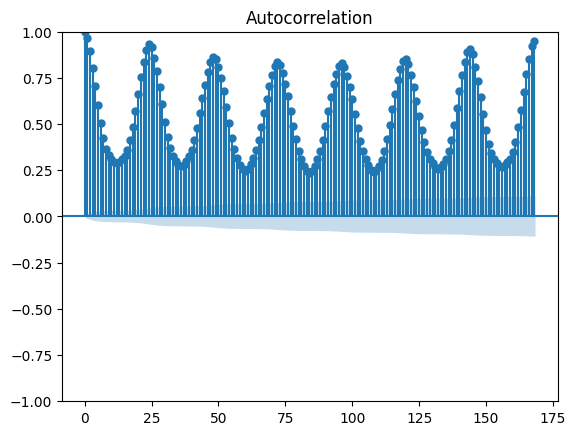

In [ ]:
plot_acf(LLC_series['Total Amount'], lags=168)
plt.show()

نلاحظ وجود ارتباط يومي تكراري للإرادات الكلية(كل 24 ساعة)


نلاحظ وجود ارتباط أسبوعي تكراري للإرادات الكلية كذلك (كل 7 أيام)

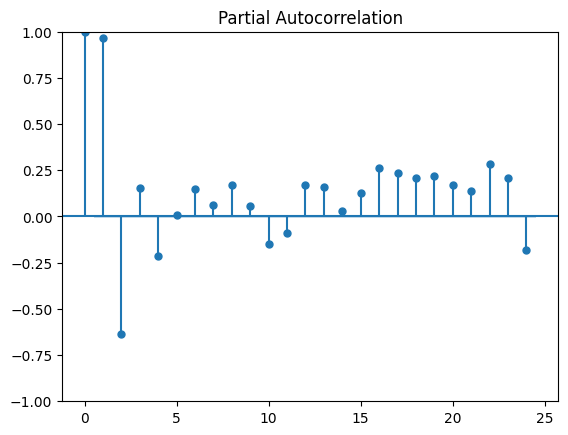

In [ ]:
plot_pacf(LLC_series['Total Amount'], lags=24, method='ywm')
plt.show()

نلاحظ الارتباط المباشر للإرادات الكلية لساعة واحدة فقط

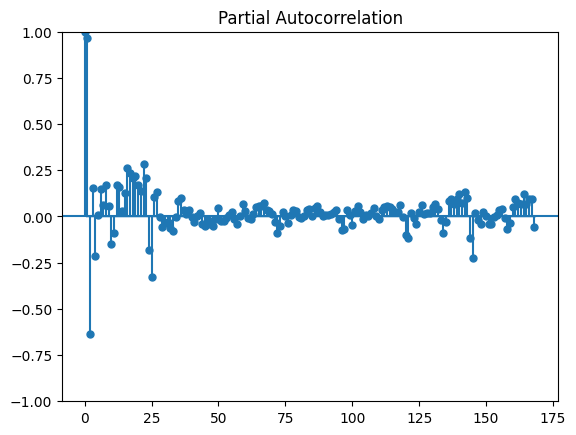

In [ ]:
plot_pacf(LLC_series['Total Amount'], lags=168, method='ywm')
plt.show()

نلاحظ وجود ارتباط مباشر بسيط للإرادات الكلية ليوم واحد

---

ثم سنقوم بدراسة السلسلة التابعة للوكالة الأولى بالنسبة لعدد الرحلات

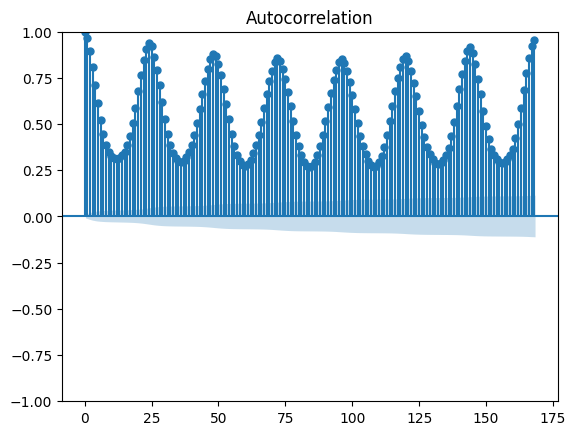

In [ ]:
plot_acf(LLC_series['Count'], lags=168)
plt.show()

نلاحظ وجود ارتباط يومي تكراري لعدد الرحلات(كل 24 ساعة)


نلاحظ وجود ارتباط أسبوعي تكراري لعدد الرحلات كذلك (كل 7 أيام)

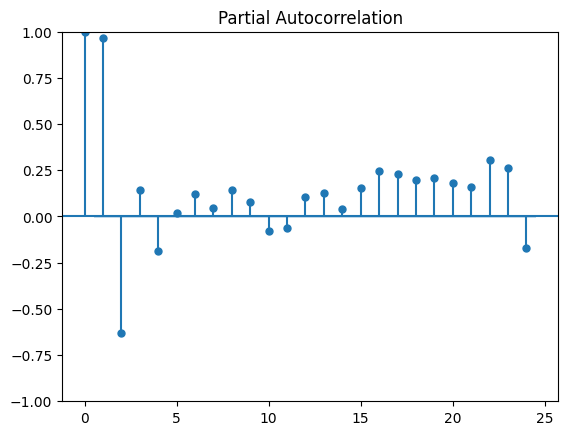

In [ ]:
plot_pacf(LLC_series['Count'], lags=24, method='ywm')
plt.show()

نلاحظ الارتباط المباشر لعدد الرحلات لساعة واحدة فقط

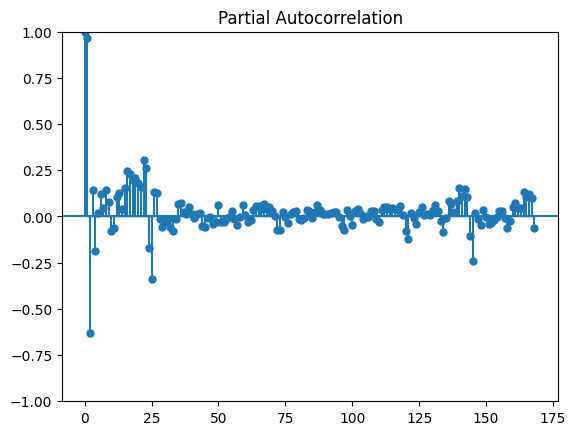

In [ ]:
plot_pacf(LLC_series['Count'], lags=168, method='ywm')
plt.show()

نلاحظ وجود ارتباط مباشر بسيط لعدد الرحلات ليوم واحد

---

 ثانياً سنقوم بدراسة السلسلة التابعة للوكالة الثانية بالنسبة للإرادات الكلية

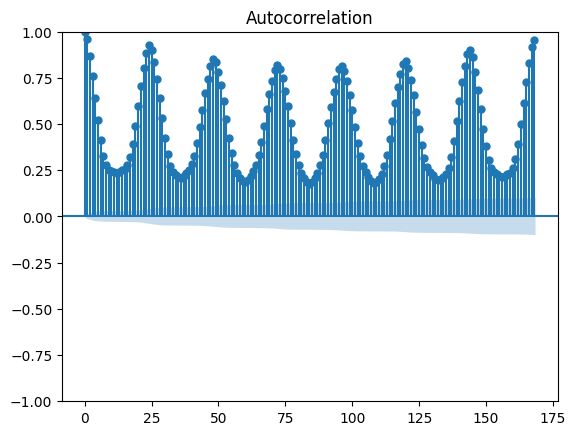

In [ ]:
plot_acf(VeriFone_series['Total Amount'], lags=168) # 7 * 24 (week)
plt.show()

نلاحظ وجود ارتباط يومي تكراري للإرادات الكلية(كل 24 ساعة)

نلاحظ وجود ارتباط أسبوعي تكراري للإرادات الكلية كذلك (كل 7 أيام)

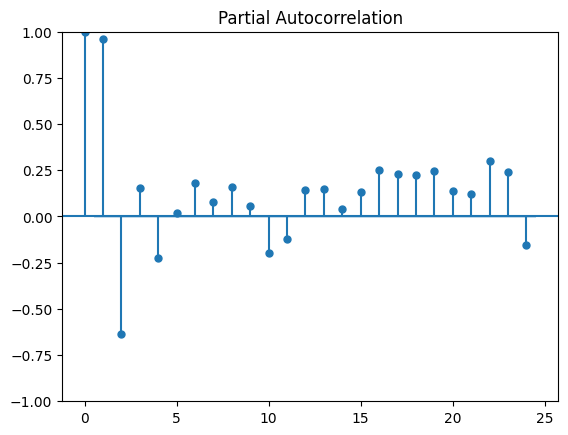

In [ ]:
plot_pacf(VeriFone_series['Total Amount'], lags=24, method='ywm')
plt.show()

نلاحظ الارتباط المباشر للإرادات الكلية لساعة واحدة فقط

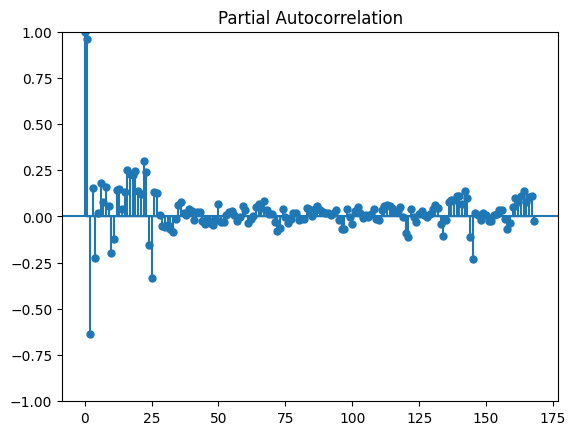

In [ ]:
plot_pacf(VeriFone_series['Total Amount'], lags=168, method='ywm')
plt.show()

نلاحظ وجود ارتباط مباشر بسيط للإرادات الكلية ليوم واحد

---

ثم سنقوم بدراسة السلسلة التابعة للوكالة الثانية بالنسبة لعدد الرحلات

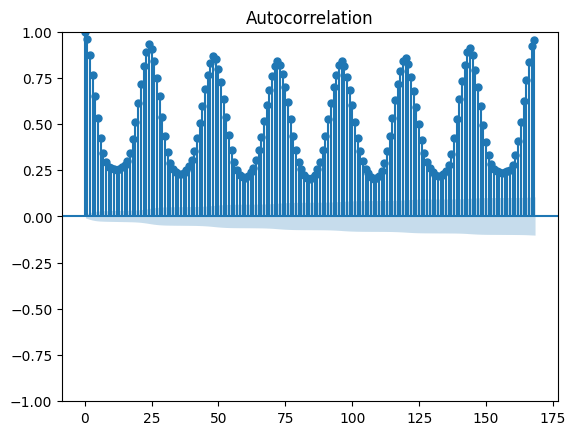

In [ ]:
plot_acf(VeriFone_series['Count'], lags=168)
plt.show()

نلاحظ وجود ارتباط يومي تكراري لعدد الرحلات(كل 24 ساعة)


نلاحظ وجود ارتباط أسبوعي تكراري لعدد الرحلات كذلك (كل 7 أيام)

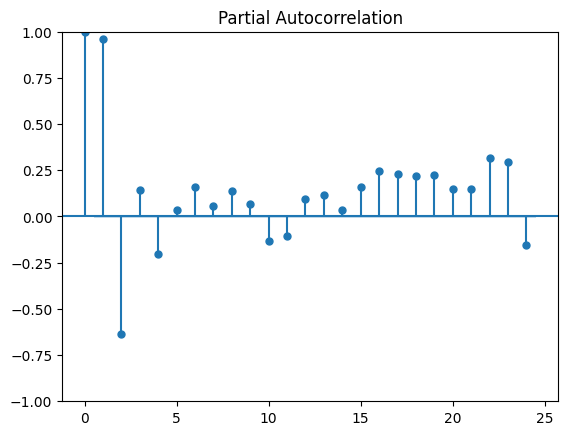

In [ ]:
plot_pacf(VeriFone_series['Count'], lags=24, method='ywm')
plt.show()

نلاحظ الارتباط المباشر لعدد الرحلات لساعة واحدة فقط

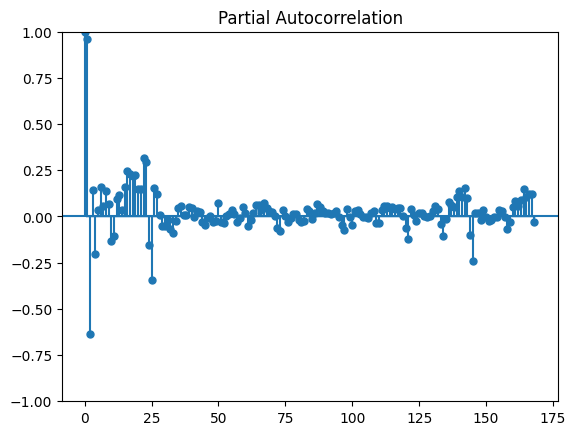

In [ ]:
plot_pacf(VeriFone_series['Count'], lags=168, method='ywm')
plt.show()

نلاحظ وجود ارتباط مباشر بسيط لعدد الرحلات ليوم واحد

### 8. تمليس السلاسل الزمنية

أولاً سنقوم بعرض كامل السلسة الزمنية الاولى بالنسبة لعامود الإرادات الكلية

In [ ]:
fig = px.line(x = LLC_series.index,
              y = LLC_series['Total Amount'],
              labels={'x': 'Date', 'y': 'Total Amount'},
              title = 'Total Values In Series')
fig.show()

سنقوم بعرض نسخة ملساء للسلسلة الزمنية الاولى بالنسبة للإرادات الكلية شهرياً

In [ ]:
monthly_rolling_LLC_series = LLC_series.rolling(720).mean() # Monthly

In [ ]:
fig = px.line(x = monthly_rolling_LLC_series.index,
              y = monthly_rolling_LLC_series['Total Amount'],
              labels={'x': 'Date', 'y': 'Total Amount'},
              title = 'Monthly Values In Series')
fig.show()

---

ثم سنقوم بعرض كامل السلسة الزمنية الاولى بالنسبة لعامود عدد الرحلات

In [ ]:
fig = px.line(x = LLC_series.index,
              y = LLC_series['Count'],
              labels={'x': 'Date', 'y': 'Trip Count'},
              title = 'Total Values In Series')
fig.show()

سنقوم بعرض نسخة ملساء للسلسلة الزمنية الاولى بالنسبة لعدد الرحلات شهرياً

In [ ]:
monthly_rolling_LLC_series = LLC_series.rolling(720).mean() # Monthly

In [ ]:
fig = px.line(x = monthly_rolling_LLC_series.index,
              y = monthly_rolling_LLC_series['Count'],
              labels={'x': 'Date', 'y': 'Trip Count'},
              title = 'Monthly Values In Series')
fig.show()

---

ثانياً سنقوم بعرض كامل السلسة الزمنية الثانية بالنسبة لعامود الإرادات الكلية

In [ ]:
fig = px.line(x = VeriFone_series.index,
              y = VeriFone_series['Total Amount'],
              labels={'x': 'Date', 'y': 'Total Amount'},
              title = 'Total Values In Series')
fig.show()

سنقوم بعرض نسخة ملساء للسلسلة الزمنية الثانية بالنسبة للإرادات الكلية شهرياً

In [ ]:
monthly_rolling_VeriFone_series = VeriFone_series.rolling(720).mean() # Monthly

In [ ]:
fig = px.line(x = monthly_rolling_VeriFone_series.index,
              y = monthly_rolling_VeriFone_series['Total Amount'],
              labels={'x': 'Date', 'y': 'Total Amount'},
              title = 'Monthly Values In Series')
fig.show()

---

ثم سنقوم بعرض كامل السلسة الزمنية الثانية بالنسبة لعامود عدد الرحلات

In [ ]:
fig = px.line(x = VeriFone_series.index,
              y = VeriFone_series['Count'],
              labels={'x': 'Date', 'y': 'Trip Count'},
              title = 'Total Values In Series')
fig.show()

سنقوم بعرض نسخة ملساء للسلسلة الزمنية الثانية بالنسبة لعدد الرحلات شهرياً

In [ ]:
monthly_rolling_VeriFone_series = VeriFone_series.rolling(720).mean() # Monthly

In [ ]:
fig = px.line(x = monthly_rolling_VeriFone_series.index,
              y = monthly_rolling_VeriFone_series['Count'],
              labels={'x': 'Date', 'y': 'Trip Count'},
              title = 'Monthly Values In Series')
fig.show()

## B. اصطياد الأنماط

### Naive Seasonal Forecast

سنقوم باستخدام نموذج بسيط يعتمد على خاصية الفصلية

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الاولى بالنسبة لعامود الإرادات الكلية باستعمال نموذج إحصائي بسيط فصليّ

In [ ]:
train, test = LLC_series[:-36], LLC_series[-36:]
test_predict = Naive_Seasonal_Forecast(train, test, 'Total Amount')

The MSE Is: 26150431.849722225


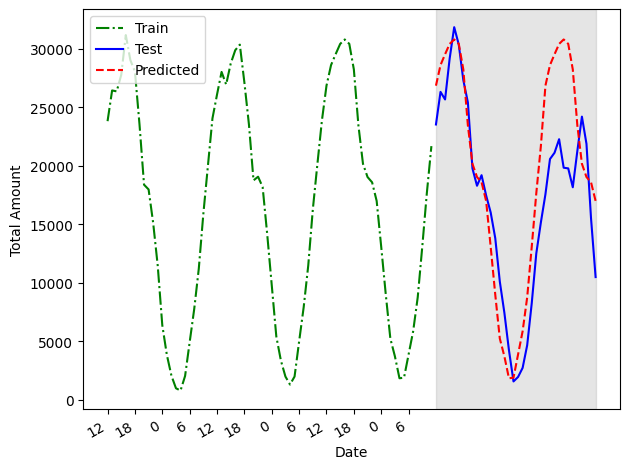

In [ ]:
mse_mean = mean_squared_error(test['Total Amount'], test_predict)
plot_predict_model(train, test, test_predict, 'Total Amount', 24*3)
print(f'The MSE Is: {mse_mean}')

In [ ]:
mape(test['Total Amount'], test_predict)

0.33300076454008226

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الاولى بالنسبة لعامود عدد الرحلات باستعمال نموذج إحصائي بسيط فصليّ

In [ ]:
train, test = LLC_series[:-36], LLC_series[-36:]
test_predict = Naive_Seasonal_Forecast(train, test, 'Count')

The MSE Is: 40280.055555555555


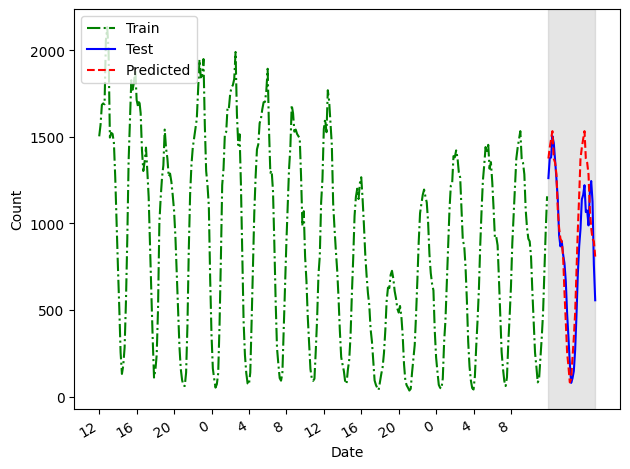

In [ ]:
mse_mean = mean_squared_error(test['Count'], test_predict)
plot_predict_model(train, test, test_predict, 'Count', 24*14)
print(f'The MSE Is: {mse_mean}')

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الثانية بالنسبة لعامود الإرادات الكلية باستعمال نموذج إحصائي بسيط فصليّ

In [ ]:
train, test = VeriFone_series[:-36], VeriFone_series[-36:]
test_predict = Naive_Seasonal_Forecast(train, test, 'Total Amount')

The MSE Is: 149041488.05538893


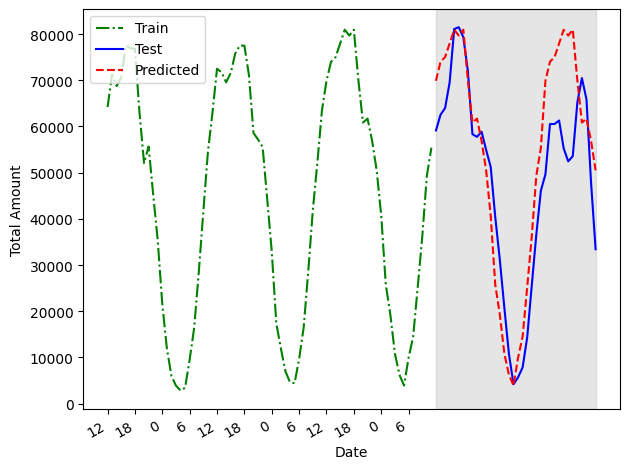

In [ ]:
mse_mean = mean_squared_error(test['Total Amount'], test_predict)
plot_predict_model(train, test, test_predict, 'Total Amount', 24*3)
print(f'The MSE Is: {mse_mean}')

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الثانية بالنسبة لعامود عدد الرحلات باستعمال نموذج إحصائي بسيط فصليّ

In [ ]:
train, test = VeriFone_series[:-36], VeriFone_series[-36:]
test_predict = Naive_Seasonal_Forecast(train, test, 'Count')

The MSE Is: 189496.25


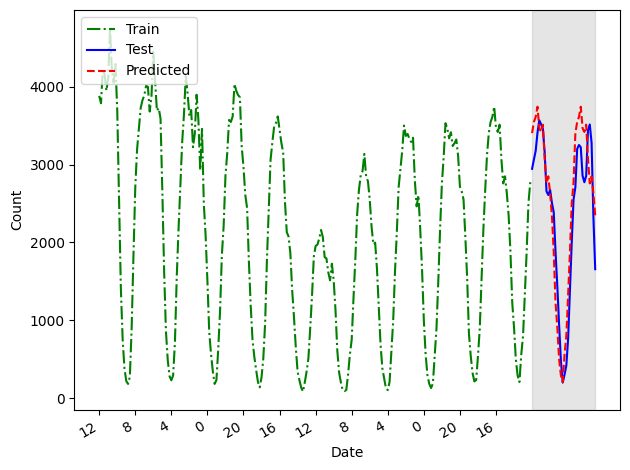

In [ ]:
mse_mean = mean_squared_error(test['Count'], test_predict)
plot_predict_model(train, test, test_predict, 'Count', 24*10)
print(f'The MSE Is: {mse_mean}')

### SARIMAX

لاحظنا مسبقا في الطلب الأول أن السلاسل الزمنية ثابتة

ولاحظنا عند دراسة الارتباط للسلاسل الزمنية أنه لا يجدي استخدام المتوسط المتحرك أو الانحدار الذاتي لهذا سنستخدم ARMA

تابع يقوم بعمل توليف لنموذج الساراماكس لإيجاد أفضل الباراميترات

عن طريق استخدام معيار AIC

In [ ]:
def optimize_SARIMAX(endog: Union[pd.Series, list], order_list: list) -> pd.DataFrame:

    results = []

    for order in tqdm_notebook(order_list):
        try:
            model = SARIMAX(endog, order=(order[0], 0, order[1]), simple_differencing=False).fit(disp=False)
        except:
            continue

        aic = model.aic
        results.append([order, aic])

    result_df = pd.DataFrame(results)
    result_df.columns = ['(p,q)', 'AIC']

    result_df = result_df.sort_values(by='AIC', ascending=True).reset_index(drop=True)

    return result_df

---

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الاولى بالنسبة لعامود الإرادات الكلية باستعمال نموذج الساراماكس



In [ ]:
LLC_total_amount = LLC_series
train, test = LLC_total_amount[:-36], LLC_total_amount[-36:]
train.shape, test.shape

((35028, 2), (36, 2))

In [ ]:
ps = range(0, 4, 1)
qs = range(0, 4, 1)

order_list = list(product(ps, qs))

In [ ]:
result_total_amount = optimize_SARIMAX(train['Total Amount'], order_list)
result_total_amount

  0%|          | 0/16 [00:00<?, ?it/s]

نلاحظ أن افضل البارمترات هي (3,3)

تابع لنموذج الساراماكس يقوم بالتنبؤ بالنتيجة المستقبلية للسلسلة الزمنية

In [ ]:
def rolling_forecast(df: pd.DataFrame, train_len: int, horizon: int, window: int, order, target_column) -> list:
    total_len = train_len + horizon
    pred_MA = []

    for i in range(train_len, total_len, window):
        model = SARIMAX(df[target_column][:i], order=order)
        res = model.fit()
        predictions = res.get_prediction(0, i + window - 1)
        oos_pred = predictions.predicted_mean.iloc[-window:]
        pred_MA.extend(oos_pred)

    return pred_MA

In [ ]:
TRAIN_LEN = len(train)
HORIZON = len(test)
WINDOW = 36
pred_ARAMA = rolling_forecast(LLC_total_amount, TRAIN_LEN, HORIZON, WINDOW, (3, 0, 3), "Total Amount")

In [ ]:
mean_squared_error(test['Total Amount'], pred_ARAMA), mape(test['Total Amount'], pred_ARAMA)

(15321828.134742532, 0.5344382316991978)

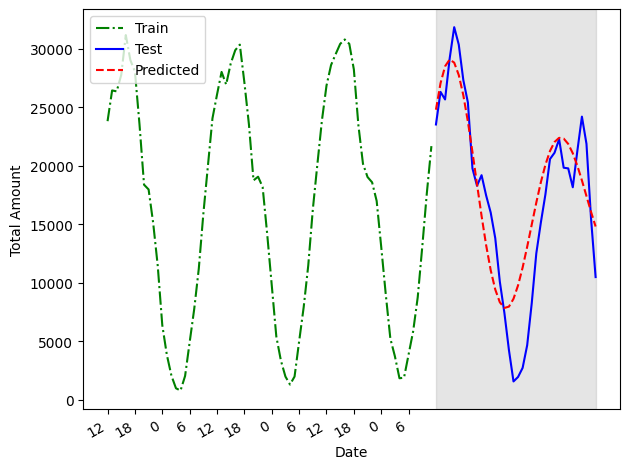

In [ ]:
plot_predict_model(train, test, pred_ARAMA, 'Total Amount', 24*3)

---

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الاولى بالنسبة لعامود عدد الرحلات باستعمال نموذج الساراماكس



In [ ]:
LLC_count = LLC_series
train, test = LLC_count[:-36], LLC_count[-36:]
train.shape, test.shape

((35028, 2), (36, 2))

In [ ]:
ps = range(0, 4, 1)
qs = range(0, 4, 1)

order_list = list(product(ps, qs))

In [ ]:
result_count = optimize_SARIMAX(train["Count"], order_list)
result_count

  0%|          | 0/16 [00:00<?, ?it/s]

نلاحظ أن افضل البارمترات هي (3,3)

In [ ]:
TRAIN_LEN = len(train)
HORIZON = len(test)
WINDOW = 36
pred_ARAMA = rolling_forecast(LLC_count, TRAIN_LEN, HORIZON, WINDOW, (3, 0, 3), "Count")

In [ ]:
mean_squared_error(test['Count'], pred_ARAMA), mape(test['Count'], pred_ARAMA)

---

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الثانية بالنسبة لعامود الإرادات الكلية باستعمال نموذج الساراماكس



In [ ]:
VeriFone_total_amount = VeriFone_series
train, test = VeriFone_total_amount[:-36], VeriFone_total_amount[-36:]
train.shape, test.shape

((35040,), (24,))

In [ ]:
ps = range(0, 4, 1)
qs = range(0, 4, 1)

order_list = list(product(ps, qs))

In [ ]:
result_total_amount2 = optimize_SARIMAX(train["Total Amount"], order_list)
result_total_amount2

  0%|          | 0/16 [00:00<?, ?it/s]

,"(p,q)",AIC
0,"(3, 3)",727480.166516
1,"(2, 3)",731765.874131
2,"(3, 2)",733855.752752
3,"(2, 2)",734045.996735
4,"(1, 2)",734057.318894
5,"(3, 1)",734079.891793
6,"(2, 1)",734082.814098
7,"(1, 3)",734289.038167
8,"(3, 0)",734816.416313
9,"(2, 0)",736199.010565


In [ ]:
TRAIN_LEN = len(train)
HORIZON = len(test)
WINDOW = 36
pred_ARAMA = rolling_forecast(VeriFone_total_amount, TRAIN_LEN, HORIZON, WINDOW, (3, 0, 3), "Total Amount")

In [ ]:
mean_squared_error(test['Total Amount'], pred_ARAMA), mape(test['Total Amount'], pred_ARAMA)

608312882.7572384

---

قمنا بنمذجة مكونات السلسلة الزمنية للوكالة الثانية بالنسبة لعامود عدد الرحلات باستعمال نموذج الساراماكس



In [ ]:
VeriFone_count = VeriFone_series
train, test = VeriFone_count[:-36], VeriFone_count[-36:]
train.shape, test.shape

((35040,), (24,))

In [ ]:
ps = range(0, 4, 1)
qs = range(0, 4, 1)

order_list = list(product(ps, qs))

In [ ]:
result_count2 = optimize_SARIMAX(train["Count"], order_list)
result_count2

  0%|          | 0/16 [00:00<?, ?it/s]

,"(p,q)",AIC
0,"(3, 3)",534010.162997
1,"(2, 3)",539241.276003
2,"(3, 2)",541259.448856
3,"(2, 2)",541318.473383
4,"(3, 1)",541360.470434
5,"(2, 1)",541374.082080
6,"(1, 3)",541493.738218
7,"(1, 2)",541498.771248
8,"(3, 0)",542031.148302
9,"(2, 0)",543295.764847


In [ ]:
TRAIN_LEN = len(train)
HORIZON = len(test)
WINDOW = 36
pred_ARAMA = rolling_forecast(VeriFone_count, TRAIN_LEN, HORIZON, WINDOW, (3,0,3), "Count")

In [ ]:
mean_squared_error(test['Count'], pred_ARAMA), mape(test['Count'], pred_ARAMA)

1555367.369255022

---

### Prophet

#### without tunning

In [ ]:
# train, test = split_train_test(LLC_series, 99.92)
LLC_series_temp = LLC_series.drop('Count', axis=1).reset_index().rename(columns={'Date':'ds', 'Total Amount':'y'})
train, test = LLC_series_temp[:-36], LLC_series_temp[-36:]

In [ ]:
layout_options = {
    'paper_bgcolor':"#383838",
    'plot_bgcolor':'#383838',
    'title_font': dict(color='white'),
    'legend_font': dict(color='white'),
    'yaxis':dict(color="white"),
    'xaxis':dict(color="white", rangeslider=dict(visible= False),
                 rangeselector=dict(visible= False)),
    }

In [ ]:
# define the model
prophet_model = Prophet()
# fit the model
prophet_model.fit(train)

DEBUG:cmdstanpy:input tempfile: /tmp/tmp470uhjyh/_2rib_py.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp470uhjyh/91gy60st.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68851', 'data', 'file=/tmp/tmp470uhjyh/_2rib_py.json', 'init=/tmp/tmp470uhjyh/91gy60st.json', 'output', 'file=/tmp/tmp470uhjyh/prophet_model1cg0kmq5/prophet_model-20230621080107.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:01:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:02:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
# define the period for which we want a prediction
future = prophet_model.make_future_dataframe(periods=36, freq='H')
# use the model to make a forecast
forecast = prophet_model.predict(future)

In [ ]:
future

,ds
0,2019-01-01 00:00:00
1,2019-01-01 01:00:00
2,2019-01-01 02:00:00
3,2019-01-01 03:00:00
4,2019-01-01 04:00:00
...,...
35059,2022-12-31 19:00:00
35060,2022-12-31 20:00:00
35061,2022-12-31 21:00:00
35062,2022-12-31 22:00:00


The MSE Is: 49510778.231352866


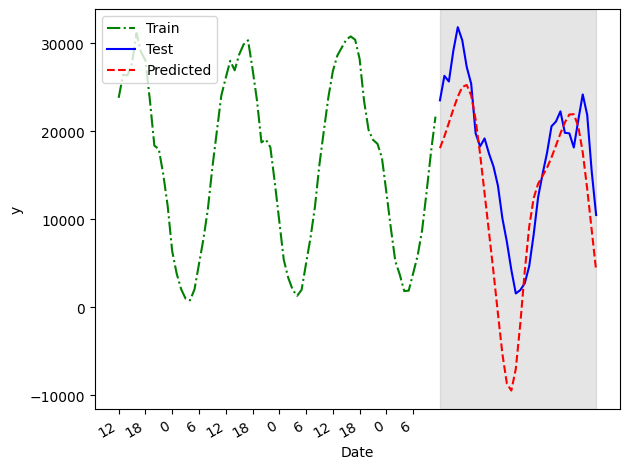

In [ ]:
mse_mean = mean_squared_error(test['y'], forecast.yhat[-36:])
plot_predict_model(train.rename(columns={'ds':'Date'}).set_index('Date'), test.rename(columns={'ds':'Date'}).set_index('Date'), forecast.yhat[-36:], 'y', 24*3)
print(f'The MSE Is: {mse_mean}')

In [ ]:
mape(test['y'], forecast.yhat[-36:])

0.6498596622274859

In [ ]:
# plot prediction
fig = plot_plotly(prophet_model, forecast, xlabel='Date', figsize=(700, 550))
fig.update_layout(title='Hour of total amount', **layout_options)
fig.update_traces(selector={'name': 'Actual'}, marker=dict(color='grey'))
fig.show()

In [ ]:
# plot component
fig = plot_components_plotly(prophet_model, forecast, figsize=(700, 400))
fig.update_layout(**layout_options)
fig.update_yaxes(**layout_options['yaxis'])
fig.update_xaxes(**layout_options['xaxis'])

#### tunning

In [ ]:
!pip install mango

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# from mango import scheduler, Tuner

# def objective_function(train_df, test_df, args_list):

#     params_evaluated = []
#     results = []

#     for params in args_list:
#         try:
#             model = Prophet(**params)
#             model.fit(train_df)
#             future = model.make_future_dataframe(periods=Test_size, freq='M')
#             forecast = model.predict(future)
#             predictions_tuned = forecast.tail(Test_size)
#             error = mape(test_df['y'], predictions_tuned['yhat'])

#             params_evaluated.append(params)
#             results.append(error)
#         except:
#             #print(f"Exception raised for {params}")
#             #pass
#             params_evaluated.append(params)
#             results.append(25.0)# Giving high loss for exceptions regions of spaces

#         #print(params_evaluated, mse)
#     return params_evaluated, results

# help

In [ ]:
import math
math.ceil(1.5)

2

In [ ]:
!jupyter nbconvert --to html '/content/nyc_taxi_mine (1).ipynb'

[NbConvertApp] Converting notebook /content/nyc_taxi_mine (1).ipynb to html
Traceback (most recent call last):
  File "/usr/local/bin/jupyter-nbconvert", line 8, in <module>
    sys.exit(main())
  File "/usr/local/lib/python3.10/dist-packages/jupyter_core/application.py", line 277, in launch_instance
    return super().launch_instance(argv=argv, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance
    app.start()
  File "/usr/local/lib/python3.10/dist-packages/nbconvert/nbconvertapp.py", line 423, in start
    self.convert_notebooks()
  File "/usr/local/lib/python3.10/dist-packages/nbconvert/nbconvertapp.py", line 597, in convert_notebooks
    self.convert_single_notebook(notebook_filename)
  File "/usr/local/lib/python3.10/dist-packages/nbconvert/nbconvertapp.py", line 560, in convert_single_notebook
    output, resources = self.export_single_notebook(
  File "/usr/local/lib/python3.10/dist-packages/nbconvert/nbconver